# Trabajo Final De Master
**Master en Data Science For Business**

Estudiantes: 
- Maria Jesús Quirós 
- Jorge Luis Barquero Villagra

# CRISP-DM

# Índice 

Pensar como hacer el índice

Para ejecutar el siguiente notebook se debe tener un ambiente de Python con las siguientes librerías instaladas.

Versión de Python 3.8.xx

- mysql-connector-python 8.4.0
- plotly 5.9.0
- mlxtend ???
- 


In [8]:
# %pip install mysql-connector-python     
# %pip install plotly                     
# %pip install mlxtend            
# %pip install networkx 
# %pip install fbprophet
# %pip install openpyxl
# %pip install nbformat

In [9]:
# Imports para ejecución del notebook
import pandas as pd
import os as os
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np
import sqlite3
from mlxtend.frequent_patterns import association_rules
from mlxtend.frequent_patterns import apriori
from prophet import Prophet

# Variable global para administrar el directorio actual
parent_dir = os.path.dirname(os.getcwd())
print (parent_dir)

# Ubicación de base de datos
database_name = '/data/database/tfm_couriers.db'

# Funciones reutilizables
def SalvarEnBD(table_name, data):
    conn = sqlite3.connect(parent_dir + database_name)
    # Convierte el DataFrame a una tabla SQL
    data.to_sql(table_name , conn, if_exists='replace', index=False)

/Users/jorgebarquero/GitRepos/couriersTFM/CouriersCR


# 1. Business Understanding

Un courier es una empresa o servicio especializado en la entrega rápida y eficiente de paquetes, documentos y otros tipos de envíos. A diferencia de los servicios postales tradicionales, los couriers suelen ofrecer una mayor velocidad, seguridad y confiabilidad en la entrega de sus envíos. Suelen caracterizarse porque sus servicios incluyen:

- Rapidez: Algunas empresas couriers pueden hacer entregas en el mismo día, al día siguiente o en un plazo muy corto, dependiendo de la urgencia del envío.
- Seguimiento: Los envíos por courier generalmente pueden ser rastreados en tiempo real, proporcionando información precisa sobre el estado y la ubicación del paquete.
- Seguridad: Los couriers a menudo ofrecen un manejo más cuidadoso de los envíos, con seguros y opciones de firma al recibir el paquete.
- Flexibilidad: Ofrecen una amplia gama de servicios, desde entregas locales y nacionales hasta envíos internacionales, adaptándose a las necesidades específicas de sus clientes.
- Servicio al cliente: Proporcionan atención personalizada y soluciones específicas para problemas o necesidades de envío.

Los couriers son utilizados tanto por particulares como por empresas que necesitan enviar documentos importantes, productos comprados en línea, muestras comerciales, y otros tipos de paquetes que requieren una entrega rápida y segura.

La empresa ExpediteX es una empresa dedicada a prestación de servicios logísticos de Courier y mensajería, que cuenta con 25 años de experiencia en el mercado. Sus servicios van desde la importación de productos en la modalidad de carga y paqueteo, distribución local y nacional a domicilio, hasta la asesoría para la importación y exportación, casillero internacional y asesoría de compras internacionales. 

Por otro lado, SwiftShip cuenta con experiencia de 19 años en el manejo y traslado de paquetes y encomiendas, se caracterizan por trabajar directamente, sea, desde el recibimiento hasta la entrega de las mercancías es manejada por la empresa directamente (sin intermediarios).

Adicionalmente cuentan con 207 sucursales y/o puntos de recepción a nivel internacional en 50 países diferentes, entre ellos Estados Unidos, Canadá, Panamá, República Dominicana, Guatemala, Venezuela, Argentina, Brasil, Chile, Colombia, Ecuador, Perú, Uruguay, España, Italia, Portugal, Alemania y el resto de la Comunidad Europea. 


Ambas empresas operan en un mercado muy competitivo, donde la eficiencia en la entrega, la cobertura geográfica y la calidad del servicio al cliente son factores clave para su éxito. Estas empresas ofrecen una variedad de servicios, que van desde la entrega de paquetes locales hasta el envío internacional, adaptándose a las necesidades de diferentes segmentos del mercado, como particulares y empresas.

La integración de tecnologías avanzadas, como el rastreo en tiempo real y la gestión automatizada de inventarios y compras juega un papel crucial en la optimización de los procesos logísticos, con lo que la incorporación de toma de la decisiones basadas en datos, tiene gran importancia en las empresas de courier, pues es crucial para optimizar sus operaciones, mejorar la satisfacción del cliente y aumentar la eficiencia en el manejo de envíos.



## Objetivo General

Desarrollar mediante la metodología CRISP-DM un análisis de datos sobre los procesos de importación de las empresas SwiftShip y ExpediteX de courier en Costa Rica durante el período 2021-2023, para la optimización de sus operaciones y mejora de la toma de decisiones estratégicas. Utilizando técnicas avanzadas de análisis de datos y las herramientas disponibles, se espera obtener al menos cinco recomendaciones concretas y presentar los hallazgos en un informe detallado en el plazo de cuatro meses.

## Objetivos Específicos

- Implementar un análisis de cesta (basket analysis) utilizando algoritmos de asociación para la identificación de los patrones más relevantes de compra y relaciones entre los productos adquiridos por los importadores que han utilizado los servicios de las empresas SwiftShip y ExpediteX de courier en Costa Rica. Utilizando los datos de transacciones de los últimos tres años, se espera la mejora en las estrategias de marketing y optimización del servicio. El análisis se lleva a cabo y los resultados se presentan en un informe detallado en un plazo de tres meses. 

- Realizar un análisis de tendencias de las mercancías importadas utilizando técnicas de análisis de series temporales, para la identificación de patrones significativos y cambios importantes en la demanda de diferentes tipos de mercancías a lo largo del tiempo. Esto permitirá la anticipación de las necesidades logísticas y ajustes de estrategias de importación para la mejora de la eficiencia operativa. Dicho análisis se completará en un plazo de seis meses.

- Diseñar un conjunto de tres variables ingenieriles específicas para la implementación en las empresas SwiftShip y ExpediteX, para la optimización de los procesos de importación bajo la modalidad courier. Utilizando técnicas de análisis de datos y conocimientos de la industria, se espera la mejora de la eficiencia y efectividad de dichos procesos. Este diseño y la implementación de un plan piloto se completarán en un plazo de cinco meses.

# 2. Data Understanding


La etapa de **Entendimiento de los Datos** es el segundo paso en el proceso CRISP-DM aplicado al análisis de las operaciones de importación de las empresas SwiftShip y ExpediteX en Costa Rica. El objetivo es comprender la complejidad y el alcance de los datos recopilados desde enero de 2021 hasta diciembre de 2023.

- **Recopilación de Datos**: Se verifica que los datos recopilados, que abarcan desde detalles de la factura hasta el peso de los envíos y los impuestos aplicados, sean accesibles y estén completos. Se presta especial atención a la integridad de los datos relacionados con las fechas de importación, los valores CIF, y las descripciones de las mercancías para asegurar una base sólida para el análisis.

- **Descripción de los Datos**: Se realiza un examen detallado de los conjuntos de datos, destacando las columnas clave como 'Año', 'DUA', 'Importador', 'Valor CIF US$', y 'Peso neto Kg.', entre otros. Se utilizan estadísticas descriptivas para obtener una visión general de la cantidad de operaciones de importación, los rangos de valores, y las tendencias generales en los datos.

- **Exploración de los Datos**: Se busca comprender las relaciones entre diferentes variables, como el impacto del país de origen en el valor CIF, o la correlación entre el peso de los envíos y los costos de flete. Herramientas de visualización de datos y análisis exploratorio son empleadas para identificar patrones estacionales, tendencias en la demanda de mercancías, y posibles anomalías o outliers.

- **Verificación de la Calidad de los Datos**: Se evalúa la calidad de los datos identificando y abordando problemas como valores faltantes en campos críticos (e.g., 'Valor CIF US$'), inconsistencias en la descripción de las mercancías, o duplicados en los registros de importación. Esta evaluación es fundamental para garantizar la precisión de los análisis de tendencias y de cesta de compras que se realizarán en etapas posteriores.

Este entendimiento profundo de los datos de importación de courier en Costa Rica es esencial para avanzar hacia los objetivos específicos del proyecto, incluyendo la implementación de análisis de cesta para identificar patrones de compra, el análisis de tendencias de las mercancías importadas, y la optimización de los procesos de importación para SwiftShip y ExpediteX.

## Definiciones

- **Aduana:** Unidad técnico-administrativa encargada de las gestiones aduaneras y del control de las entradas, la permanencia y la salida de las mercancías objeto del comercio internacional (Art. 13 LGA).

- **Agente aduanero:** Profesional auxiliar de la función pública aduanera autorizado por la DGA para actuar, en su carácter de persona natural en la presentación habitual de servicios a terceros, en los trámites, los regímenes y las operaciones aduaneras. (Art. 33, LGA)

- **Auxiliar de la Función Pública:**  Personas físicas o jurídicas, públicas o privadas, que participen habitualmente ante el Servicio Nacional de Aduanas (SNA), en nombre propio o de terceros. (Art. 28 LGA). 

- **Bultos:** Unidad utilizada para contener mercancías. Puede consistir en cajas, sacas, fardos, cilindros y demás formas de presentación de las mercancías, según su naturaleza (Ministerio de Hacienda, 2021). 

- **Código Sistema Arancelario Centroamericano (SAC):** El Arancel Centroamericano de Importación está constituido por el Sistema Arancelario Centroamericano (SAC) y los correspondientes Derechos Arancelarios a la Importación (DAI). El código numérico del SAC está representado por diez dígitos que identifican: los dos primeros, al capítulo; los dos siguientes, a la partida; el tercer par, a la subpartida; y los cuatro últimos, a los incisos arancelarios. La identificación de las mercancías se hará siempre con los diez dígitos de dicho código numérico. (Estrategia Aduanera, s.f.)

- **Código Sistema Armonizado (SA):** El Sistema Armonizado (SA) es un código de clasificación de mercancías creado por la Organización Mundial de Aduanas (OMA) y está compuesto por 6 dígitos con aceptación en todo el mundo. Sirve para llevar un control en las mercancías de exportación e importación en cuanto a los impuestos internos, monitoreo de bienes, origen y materia constitutiva. 

- **Declarante:** El importador o consignatario, en el caso de la importación de mercancías. 

- **Depositario Aduanero:** Persona física o jurídica, pública o privada, auxiliar de la función pública aduanera autorizadas mediante concesión por la DGA, que custodian y conservan temporalmente y con suspensión del pago de tributos, mercancías objeto de comercio exterior, bajo la supervisión y el control de la autoridad aduanera. (Ministerio de Hacienda, 2021). 

- **Derechos Arancelarios a la Importación (DAI):**  Derechos Arancelarios a la Importación que son un porcentaje estipulado por tipo de mercancías y se calcula sobre el Valor Aduanero. 

- **Descripción o designación de la mercancía:** Precisa identificación de las características de ésta, sea de manera concreta, detallada, que singulariza de tal forma el objeto a clasificar que no deja duda alguna sobre su tipificación. (Quirós, 2024).

- **DUA:** Documento Único Aduanero, declaración realizada mediante transmisión electrónica de datos, mediante la cual se indica el régimen aduanero y la modalidad que deberá aplicarse a las mercancías (Ministerio de Hacienda, 2021). 

- **Empresa de entrega rápida (EER):** Personas físicas o jurídicas legalmente establecidas, autorizadas y registradas ante la DGA, cuyo giro o actividad principal es la prestación de servicios de transporte internacional expreso a terceros, de correspondencia, documentos y envíos de mercancías bajo la modalidad de entrega rápida. (Ministerio de Hacienda, 2021).

- **Envíos de entrega rápida:** Documentos y mercancías transportadas bajo sistemas de entrega rápida o courier, consignadas a terceros. (Ministerio de Hacienda, 2021).

- **Factura Comercial:**  Documento expedido conforme a los usos y las costumbres comerciales, justificativo de un contrato de compraventa de mercancías o servicios extendido por el vendedor a nombre y cargo del comprador.

- **Fecha:** Fecha en que fue aceptado el DUA por el Sistema de Tecnología de Información para el Control Aduanero (TICA) de Costa Rica.

- **Flete:** Monto de flete desde el origen, o sea desde el momento en que se elabora el conocimiento de embarque original y se inicia el servicio de transporte hasta el puerto o lugar de importación. (Ministerio de Hacienda, 2021).

- **Identificación (ID) Agente:** Cédula de identidad física u jurídica del Agente Aduanero. 

- **Identificación (ID) Declarante:** En el caso que nos ataque, el número de identificación de la empresa declarante ante el Ministerio de Hacienda.

- **Identificación (ID) Localización:** Número de identificación de la empresa donde está localizada la mercancía, en el caso de envíos de courier, suele referirse al Depositario Aduanero o Almacén fiscal. 

- **Importador:** Empresario o empresa que se dedica a comprar productos a clientes del exterior para luego venderlos en el mercado local o para consumo o uso propio. 

- **Impuesto sobre el Valor Agregado (IVA):** Según el artículo 1 de la Ley 9635, el impuesto sobre el valor agregado se establece en la venta de bienes y en la prestación de servicios, independientemente del medio por el que sean prestados, realizados en el territorio en Costa Rica.

- **Impuestos Selectivo de Consumo (SC):** Impuesto establecido sobre bienes y servicios específicos, por razones que dependen de cada Estado. Entre las razones más comunes para gravar un bien específico se encuentra, por ejemplo, el carácter indemnizatorio o el desincentivador que se pretende implementar sobre o por el consumo o realización de este. Así, es que las bebidas alcohólicas, el tabaco, y la marihuana

- **Impuestos:** Los Derechos o impuestos a la importación corresponden al monto de tributos que el fisco recauda debido al ingreso de una mercancía extranjera al comercio nacional. (Ministerio de Hacienda, 2024).

- **Ítem:** Línea del DUA donde se describe e indica la cantidad de las mercancías que se presentan para ser destinadas a un régimen aduanero determinado. 

- **Ley 6946:** Tarifa de Ley N°6946, de un 1% aplicable sobre el valor aduanero.

- **Localización:** véase Depositario Aduanero.

- **Medio o modo de transporte:** Nave, aeronave, vagón ferroviario, vehículo automotor, o cualquier otro medio utilizado para el transporte de personas o mercancías. (Ministerio de Hacienda, 2021)

- **Mercancía:** Objeto susceptible de ser apropiado y, por ende, importado o exportado, clasificado conforme al arancel de aduanas.

- **Modalidad:** Cada régimen aduanero contará con modalidades según detalle, por ejemplo, la importación puede ser modalidad importación definitiva, temporal, courier, entre otras. 

- **Modelo:** De las mercancías que se adquieren, por ejemplo en sitios web y se trasladan a Costa Rica, bajo la modalidad de courier.

- **Nota técnica:** requisitos no arancelarios o autorizaciones preestablecidos por la institución rectora mediante leyes y decretos, que avalan el ingreso o salida de las mercancías del o al territorio nacional. (Ministerio de Hacienda, 2021)

- **País de adquisición:** País en donde se adquirido el servicio o mercancía. 

- **País de origen:** País de donde, según lo establecido en el Tratado de Libre Comercio, son originarias las mercancías o servicios. 

- **País de procedencia:** País de donde procede la mercancía, que no necesariamente coincide con el país de origen o de adquisición. 

- **Peso bruto:** El peso bruto es el peso total de un producto más su empaque o contenedor.

- **Peso neto:** El peso neto de un producto, sea únicamente el peso del producto en sí. 

- **Precio FOB:** FOB es un término comercial que pertenece a los Incoterms, corresponde a las siglas en inglés de 'Free on board'. El Precio FOB se determina por: precio de la mercancía,  el precio de embalaje y etiquetado, precio por transporte desde la planta de producción hasta el puerto de origen, el precio del seguro de la mercancía durante su traslado a puerto, gastos administrativos generados por la concesión de permisos o licencias, gastos derivados de las autoridades aduaneras, algunos gastos bancarios resultantes de pagos y transferencias internacionales y gastos portuarios, como uso de muelle, elevadores o estiba.

- **PROCOMER:** Promotora de Comercio Exterior de Costa Rica, pago de $3 por cada declaración aduanera transmitida electrónicamente, para la institución. 

- **Proveedor:** Persona física o jurídica que suministra profesionalmente un determinado bien o servicio a otros individuos o sociedades, como forma de actividad económica y a cambio de una contra prestación.

- **Régimen:** Diferentes destinaciones a que pueden quedar sujetas las mercancías que se encuentran bajo control aduanero (Art 109. LGA)

- **Seguro:** Protección de la carga desde que sale del depósito del vendedor hasta las bodegas del comprador, o según INCOTERM.

- **Unidad de medida:** Referencia convencional que se usa para medir la magnitud física de un determinado objeto, sustancia o fenómeno. 

- **Valor CIF:** Representa el precio total de la mercancía, incluyendo el coste, del seguro y el flete hasta el puerto de destino acordado. 

- **Valor en Aduana:** El valor de transacción, o precio realmente pagado o por pagar por las mercancías cuando éstas se venden para su exportación al país de importación.

## **Paso 1:** 

Se inicia con una carga del conjunto de datos, ubicado en la carpeta '/data/raw/' de nuestro directorio. Para evitar problemas de ubicación, se utiliza la variable parent_dir que representa el directorio padre de la solución.

In [10]:
# Lectura del archivo de datos y almacenamiento en variable data
data = pd.read_excel (parent_dir + '/data/raw/data.xlsx', sheet_name='UnifiedData')
data.head()

,DUA,Item del DUA,Fecha DUA,Aduana,Regimen,Modalidad,Importador,Proveedor,Marca,Modelo,...,Total IVA US$,% Ley 6946,Total Ley 6946 US$,% DAI,Total DAI US$,COSTO por PROCOMER US$,% S.C,Total SC US$,Otros impuestos US$,Total de Impuestos
0,005-2022-001495,1,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,6.45,1,0.43,14,6.04,3,0,0.00,0.11,16.03
1,005-2022-001495,2,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,92.12,1,5.61,14,78.49,0,10,63.91,0.00,240.13
2,005-2022-001495,3,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,86.12,1,5.76,14,80.65,0,0,0.00,0.00,172.53
3,005-2022-001495,4,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,51.21,1,3.58,9,32.23,0,0,0.00,0.00,87.02
4,005-2022-001495,5,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,9.54,1,0.64,14,8.94,0,0,0.00,0.00,19.12


2.2. Descripción de valores en columnas de datos  --- REVISARLO


1. **Año**: Año en que se realizaron las importaciones.
2. **DUA**: Documento Único Administrativo, identificador de la operación de importación.
3. **Item**: Número de ítem en la factura.
4. **Fecha**: Fecha de la operación de importación.
5. **Aduana**: Aduana por la que ingresaron los productos.
6. **Regimen**: Régimen aduanero bajo el cual se importaron los productos.
7. **Modalidad**: Modalidad de importación.
8. **Importador**: Empresa que importó los productos.
9. **Proveedor**: Proveedor de los productos importados.
10. **Marca**: Marca de los productos importados.
11. **Modelo**: Modelo de los productos importados.
12. **Factura**: Número de factura de la operación de importación.
13. **Código SAC**: Código del Sistema Armonizado de Designación y Codificación de Mercancías.
14. **Vía Transporte**: Vía por la que se transportaron los productos.
15. **País de Origen**: País de origen de los productos.
16. **Pais de Procedencia**: País de procedencia de los productos.
17. **Pais de Adquisición**: País donde se adquirieron los productos.
18. **Cantidad Comercial**: Cantidad de productos importados.
19. **Unidad de Medida**: Unidad de medida de los productos importados.
20. **Volúmen Físico**: Volumen físico de los productos importados.
21. **Bultos**: Cantidad de bultos en los que se transportaron los productos.
22. **U$S FOB**: Valor FOB (Free On Board) de los productos en dólares estadounidenses.
23. **U$S FOB Unit.**: Valor unitario FOB de los productos en dólares estadounidenses.
24. **U$S Flete**: Costo del flete en dólares estadounidenses.
25. **U$S Seguro**: Costo del seguro en dólares estadounidenses.
26. **U$S CIF**: Valor CIF (Cost, Insurance and Freight) de los productos en dólares estadounidenses.
27. **U$S Unitario**: Valor unitario de los productos en dólares estadounidenses.
28. **Valor en Aduana U$S**: Valor en aduana de los productos en dólares estadounidenses.
29. **Kg netos**: Peso neto de los productos en kilogramos.
30. **Kg brutos**: Peso bruto de los productos en kilogramos.
31. **Descripción de Mercancía**: Descripción de los productos importados.
32. **ID Declarante**: Identificador del declarante.
33. **Declarante**: Nombre del declarante.
34. **ID Agente**: Identificador del agente de aduanas.
35. **Agente**: Nombre del agente de aduanas.
36. **ID Localización**: Identificador de la localización.
37. **Localización**: Localización de la operación de importación.
38. **% IVA**: Porcentaje del Impuesto al Valor Agregado.
39. **IVA - U$S**: Valor del IVA en dólares estadounidenses.
40. **% Ley 6946**: Porcentaje de la Ley 6946.
41. **Ley 6946 U$S**: Valor de la Ley 6946 en dólares estadounidenses.
42. **% DAI**: Porcentaje del Derecho Arancelario de Importación.
43. **DAI U$S**: Valor del DAI en dólares estadounidenses.
44. **PROCOMER U$S**: Valor de PROCOMER en dólares estadounidenses.
45. **% S.C**: Porcentaje de S.C.
46. **S.C. U$S**: Valor de S.C en dólares estadounidenses.
47. **Otros Imp. U$S**: Otros impuestos en dólares estadounidenses.
48. **Total de Impuestos**: Total de impuestos de la operación de importación.
49. **Proporción Pr FOB / impuestos**: Proporción entre el valor FOB y los impuestos.
50. **Proporción VA / impuestos**: Proporción entre el valor en aduana y los impuestos.

Se realiza un análisis descriptivo de los datos para... 

In [11]:
# Métricas descriptivas de los datos
data.describe()

,Item del DUA,Fecha DUA,Código SAC,CodSA,Cantidad,Volúmen Físico,Cantidad de bultos,Valor FOB US$,Valor FOB US$ por unidad,Costo flete US$,...,Peso bruto en Lbs.,ID Declarante,ID Agente Aduanero,Total IVA US$,Total Ley 6946 US$,Total DAI US$,COSTO por PROCOMER US$,Total SC US$,Otros impuestos US$,Total de Impuestos
count,178434.000000,178434,1.784340e+05,178434.000000,178434.000000,178434.000000,178434.000000,178434.000000,178434.000000,178434.000000,...,178434.000000,1.784340e+05,1.784340e+05,178434.000000,178434.000000,178434.000000,178434.000000,178434.000000,178434.000000,178434.00000
mean,63.527013,2022-06-23 05:30:13.497427712,7.354078e+11,7353.581459,1.891257,1.113133,0.755170,43.680059,37.911004,6.146155,...,9.459135,3.100034e+11,3.315567e+10,6.062704,0.376309,3.501689,0.066882,0.812547,0.003029,10.82316
min,1.000000,2021-01-04 00:00:00,2.508300e+11,2508.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.022046,1.087709e+08,1.087709e+08,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,12.000000,2021-08-05 00:00:00,6.206300e+11,6206.000000,1.000000,1.000000,0.000000,8.400000,6.800000,2.330000,...,2.579382,3.101314e+11,1.104307e+08,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.59000
50%,46.000000,2022-04-06 00:00:00,8.409910e+11,8409.000000,1.000000,1.000000,1.000000,16.000000,13.180000,3.500000,...,5.136718,3.101314e+11,1.104307e+08,2.230000,0.140000,0.940000,0.000000,0.000000,0.000000,3.94000
75%,100.000000,2023-05-17 00:00:00,8.544421e+11,8544.000000,1.000000,1.000000,1.000000,39.980000,32.780000,7.000000,...,11.023000,3.101314e+11,1.104307e+08,5.790000,0.360000,3.320000,0.000000,0.000000,0.000000,10.43000
max,480.000000,2023-12-28 00:00:00,9.706900e+11,9706.000000,19100.000000,84.000000,23.000000,985.500000,985.500000,595.000000,...,639.334000,3.101607e+11,1.862004e+11,190.890000,11.530000,161.370000,3.000000,242.510000,12.000000,476.31000
std,60.202672,NaN,1.844334e+11,1844.416160,47.754203,1.145816,0.517765,84.625879,77.876544,9.247828,...,20.994796,6.438089e+09,7.109965e+10,12.400669,0.797761,8.447561,0.442915,5.652555,0.065990,23.05286


Se verifica la existencia de valores nulos en el conjunto de datos 

In [12]:
# Revisión de valores faltantes
data.isnull().sum()

DUA                         0
Item del DUA                0
Fecha DUA                   0
Aduana                      0
Regimen                     0
Modalidad                   0
Importador                  0
Proveedor                   0
Marca                       0
Modelo                      0
Factura                     0
Código SAC                  0
CodSA                       0
Modo transporte             0
País de Origen              0
Pais de Procedencia         0
Pais de Adquisición         0
Cantidad                    0
Unidad de Medida            0
Volúmen Físico              0
Cantidad de bultos          0
Valor FOB US$               0
Valor FOB US$ por unidad    0
Costo flete US$             0
Costo seguro US$            0
Valor CIF US$               0
Valor CIF US$  unitario     0
Valor en Aduana US$         0
Peso neto Kg.               0
Peso bruto Kg.              0
Peso bruto en Lbs.          0
Descripción de Mercancía    0
ID Declarante               0
Declarante

In [13]:
data['Año'] = data['DUA'].str[4:8]
# Mover la columna Anno a la primera posición
año = data.pop('Año')
data.insert(0, 'Año', año)
data.head()

,Año,DUA,Item del DUA,Fecha DUA,Aduana,Regimen,Modalidad,Importador,Proveedor,Marca,...,Total IVA US$,% Ley 6946,Total Ley 6946 US$,% DAI,Total DAI US$,COSTO por PROCOMER US$,% S.C,Total SC US$,Otros impuestos US$,Total de Impuestos
0,2022,005-2022-001495,1,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,6.45,1,0.43,14,6.04,3,0,0.00,0.11,16.03
1,2022,005-2022-001495,2,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,92.12,1,5.61,14,78.49,0,10,63.91,0.00,240.13
2,2022,005-2022-001495,3,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,86.12,1,5.76,14,80.65,0,0,0.00,0.00,172.53
3,2022,005-2022-001495,4,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,51.21,1,3.58,9,32.23,0,0,0.00,0.00,87.02
4,2022,005-2022-001495,5,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,9.54,1,0.64,14,8.94,0,0,0.00,0.00,19.12


In [14]:
# Se cuenta con información de dos años completos
distinct_values = data['Año'].unique()
print(distinct_values)

['2022' '2023' '2021']


In [15]:
print(data.columns)

Index(['Año', 'DUA', 'Item del DUA', 'Fecha DUA', 'Aduana', 'Regimen',
       'Modalidad', 'Importador', 'Proveedor', 'Marca', 'Modelo', 'Factura',
       'Código SAC', 'CodSA', 'Modo transporte', 'País de Origen',
       'Pais de Procedencia', 'Pais de Adquisición', 'Cantidad',
       'Unidad de Medida', 'Volúmen Físico', 'Cantidad de bultos',
       'Valor FOB US$', 'Valor FOB US$ por unidad', 'Costo flete US$',
       'Costo seguro US$', 'Valor CIF US$', 'Valor CIF US$  unitario',
       'Valor en Aduana US$', 'Peso neto Kg.', 'Peso bruto Kg.',
       'Peso bruto en Lbs.', 'Descripción de Mercancía', 'ID Declarante',
       'Declarante', 'ID Agente Aduanero', 'Agente aduanero',
       'ID Localización', 'Localización', '% IVA', 'Total IVA US$',
       '% Ley 6946', 'Total Ley 6946 US$', '% DAI', 'Total DAI US$',
       'COSTO por PROCOMER US$', '% S.C', 'Total SC US$',
       'Otros impuestos US$', 'Total de Impuestos'],
      dtype='object')


### Proceso de creación y conexión a base de datos

Una vez ordenados y definida la información es necesario respaldar los datos en la base de datos.
Para esto, se utiliza una base de datos SQLlite para almacenarlos.

In [16]:
# Connect to the SQLite database
# SalvarEnBD('FactDatosCouriers', data)

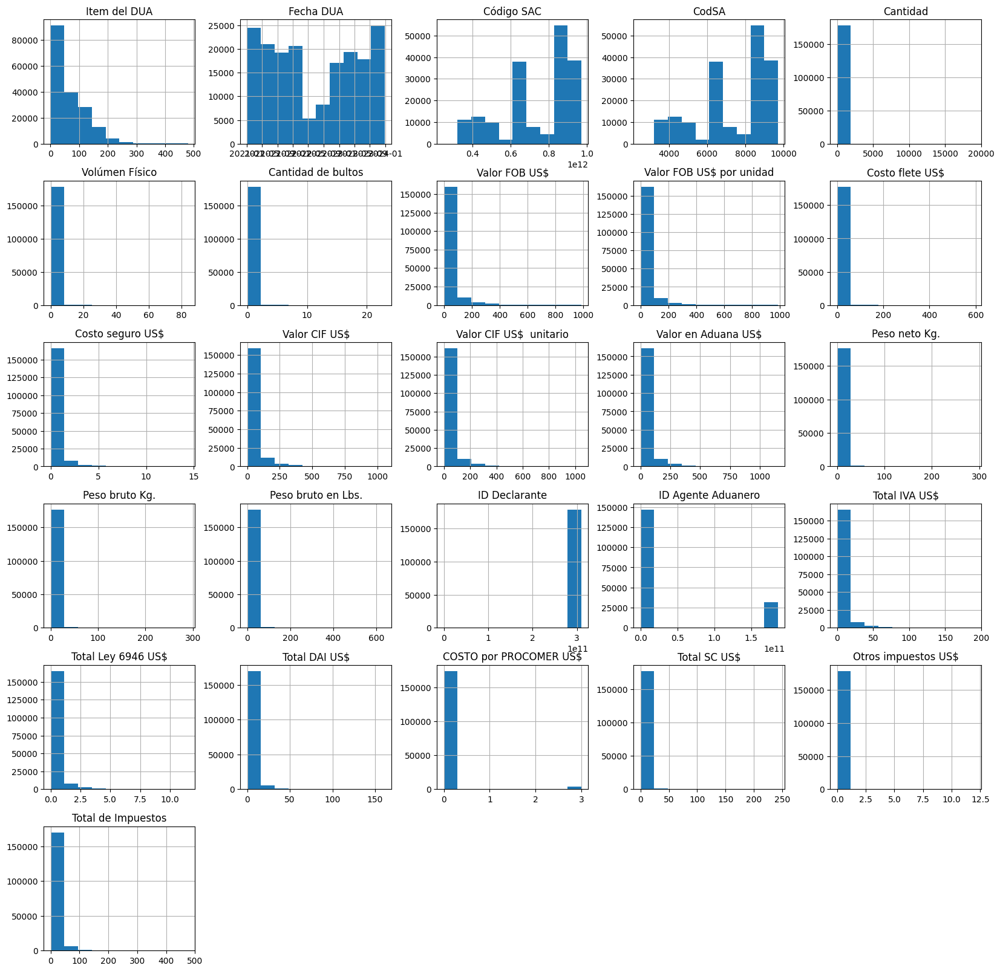

In [17]:
data.hist(figsize=(20, 20))
plt.show()
#bank_data.histo

ESTO HAY QUE DEFINIR PARA QUÉ nos sirve 


## Análisis de la cantidad de DUAs por Mes y Código SAC

Para realizar un análisis más detallado de la cantidad de DUAs por mes y código SAC, hemos utilizado Python y Plotly para crear un gráfico de barras interactivo. Este gráfico nos permite visualizar la distribución de la cantidad de DUAs para un importador específico en un año determinado.

### Procedimiento

1. **Filtrado de datos**: Primero, hemos filtrado los datos para seleccionar un año específico y un importador particular. En este caso, hemos seleccionado el año 2022 y el importador 'LIBERTY EXPRESS CORPORATE VC SOCIEDAD AN'.

2. **Agrupación de datos**: Luego, hemos agrupado los datos filtrados por mes y código SAC, contando la cantidad de DUAs en cada grupo.

3. **Creación del gráfico de barras**: Utilizando Plotly Express, hemos creado un gráfico de barras que muestra la cantidad de DUAs por mes y código SAC para el año e importador seleccionados. Cada barra representa la cantidad de DUAs asociadas a un código SAC específico en un mes determinado.

### Interpretación

Este gráfico nos permite identificar patrones o tendencias en la distribución de la cantidad de DUAs para el importador seleccionado a lo largo del año 2022. Podemos observar qué tipos de productos (definidos por el código SAC) tienen una mayor o menor incidencia en diferentes meses del año, lo que puede proporcionar información útil para la planificación y la toma de decisiones estratégicas en la gestión de importaciones.


In [43]:
import plotly.express as px

# Group the data by year, importador, month, and Código SAC and count the number of DUAs
duas_by_year_importador_month_sac = data.groupby(['Año', 'Importador', 'Mes', 'Código SAC']).size().reset_index(name='Cantidad_DUAs')

# Create the graph for all importers and years
fig = px.bar(duas_by_year_importador_month_sac, x='Mes', y='Cantidad_DUAs', color='Código SAC',
             facet_col='Año', facet_row='Importador',
             labels={'Mes': 'Mes', 'Cantidad_DUAs': 'Cantidad de DUAs', 'Código SAC': 'Código SAC'},
             width=800, height=600)

# Update the layout of the graph
fig.update_layout(title='Cantidad de DUAs por Mes y Código SAC para todos los importadores y años',
                  xaxis_title='Mes', yaxis_title='Cantidad de DUAs')

# Show the graph
fig.show()


Este código es útil para el análisis de datos ya que permite visualizar las 20 principales operaciones de importación (DUAs) en términos de U$S FOB. FOB (Free On Board) es un término de comercio internacional que indica el valor de los bienes en el punto de embarque, es decir, el valor de los bienes antes de ser exportados.

Al visualizar estos datos, los analistas pueden identificar rápidamente cuáles son las operaciones de importación más valiosas en términos de U$S FOB. Esto puede ser útil para identificar tendencias, patrones o anomalías en los datos, lo que puede informar decisiones comerciales o estratégicas

In [19]:
import pandas as pd


def plot_top_20_duas(data):
    """
    Plot the top 20 DUAs by U$S FOB using plotly.express.

    Parameters:
    - data (pandas.DataFrame): The input DataFrame containing the data.

    Returns:
    - None
    """
    # Filter the DataFrame to include only the top 20 DUAs
    top_20_duas = data['DUA'].value_counts().head(20).index
    filtered_data = data[data['DUA'].isin(top_20_duas)]

    # Aggregate the data to get the sum of U$S FOB for each DUA
    aggregated_data = filtered_data.groupby('DUA')['Valor FOB US$'].sum().reset_index()

    aggregated_data = aggregated_data.sort_values(by='Valor FOB US$', ascending=False)

    # Create the graphic using the filtered data
    fig = px.bar(aggregated_data, x='DUA', y='Valor FOB US$',
                 labels={'DUA': 'DUA', 'Valor FOB US$': 'Valor FOB US$'},
                 title='Top 20 DUAs by Valor FOB US$')
    fig.update_layout(xaxis_tickangle=-90)
    fig.show()

# Example usage (assuming 'data' is your DataFrame):
# data = pd.read_csv('your_data.csv')  # Replace with your data source
plot_top_20_duas(data)


??? Porque CIF? 


U$S CIF vs. Kg netos: Esta comparación puede ayudar a entender si hay alguna relación entre el costo de las mercancías y su peso neto. Podría ser útil para identificar si los productos más pesados tienden a ser más costosos o si existe alguna otra relación entre estas dos variables.

### PENDIENTE DEFINIR SI ESTO NOS SIRVE

In [20]:
#import plotly.express as px

# Create the scatter plot with different colors based on the importer and hover information including 'Descripción de Mercancía'
fig_cif_vs_kg = px.scatter(data, x='Peso neto Kg.', y='Valor CIF US$', color='Importador',
                           title='U$S CIF vs. Kg netos',
                           hover_data={'Descripción de Mercancía': True})

# Show the plot
fig_cif_vs_kg.show()


## Visualización de Datos

Comparar las cantidades importadas por las dos empresas en cada año.



## Análisis de Cantidades Importadas por Empresa y Año

Este bloque de código contribuye significativamente a la etapa de **Entendimiento de los Datos** en el estudio CRISP-DM para las operaciones de importación de las empresas SwiftShip y ExpediteX en Costa Rica. La función `create_pivot_table` y `plot_pivot_table` trabajan en conjunto para transformar y visualizar los datos de importaciones, facilitando la identificación de tendencias y patrones en las cantidades importadas por cada empresa a lo largo de los años. A continuación, se detalla cómo cada función apoya este análisis:

### `create_pivot_table(data)`
- **Objetivo**: Crear una tabla pivote que resume las cantidades totales importadas por cada importador (empresa) por año.
- **Proceso**: La función toma como entrada el conjunto de datos de importaciones, agrupa las cantidades (`Cantidad`) por año (`Año`) y por importador (`Importador`), y suma estas cantidades para cada combinación de año e importador.
- **Resultado**: Una tabla pivote que facilita la comparación de las cantidades importadas por cada empresa a lo largo del tiempo, lo cual es esencial para entender la dinámica del mercado y la participación de cada empresa.

### `plot_pivot_table(pivot_df)`
- **Objetivo**: Visualizar las cantidades importadas por cada empresa a lo largo de los años.
- **Proceso**: Transforma la tabla pivote en un formato largo adecuado para la visualización con Plotly, y luego crea un gráfico de barras apiladas que muestra las cantidades importadas por año y por empresa.
- **Resultado**: Un gráfico claro y atractivo que permite identificar visualmente tendencias, patrones estacionales, y cambios en la demanda de importaciones entre las empresas SwiftShip y ExpediteX a lo largo del tiempo.

### Impacto en el Estudio CRISP-DM
Este bloque de código es fundamental para la fase de **Entendimiento de los Datos**, ya que proporciona insights visuales inmediatos sobre cómo las cantidades importadas varían entre las empresas y a lo largo de los años. Estos insights son cruciales para:
- Identificar tendencias de crecimiento o declive en las importaciones.
- Reconocer la estacionalidad y cómo ciertos eventos o periodos del año afectan las cantidades importadas.
- Preparar el terreno para análisis más profundos, como el análisis de cesta y el análisis de series temporales, al destacar los años o importadores que podrían requerir atención especial.

En resumen, este bloque de código mejora significativamente la comprensión de los patrones de importación y es un paso esencial hacia el logro de los objetivos específicos del proyecto.

In [21]:
def create_pivot_table(data):
    pivot_df = data.pivot_table(index='Año', columns='Importador', values='Cantidad', aggfunc='sum').reset_index()
    plot_pivot_table(pivot_df)

def plot_pivot_table(pivot_df):

    # Preparar los datos para Plotly
    pivot_df_long = pivot_df.melt(id_vars='Año', var_name='Importador', value_name='Cantidad')
    
    # Crear el gráfico de barras con Plotly
    fig = px.bar(pivot_df_long, x='Año', y='Cantidad', color='Importador', title='Cantidades Importadas por Cada Empresa Cada Año',
                 labels={'Cantidad': 'Cantidad Importada', 'Año': 'Año'}, barmode='stack')
    
    # Mostrar el gráfico
    fig.show()
    
create_pivot_table(data)


## U$S CIF vs. Año con Importador
Comparar el costo de las mercancías a lo largo de los años puede revelar tendencias o patrones en los precios a lo largo del tiempo. Agregar la variable 'Importador' al gráfico de dispersión nos permite examinar cómo varía el costo CIF en función del año, y además nos brinda información sobre diferentes importadores y su impacto en los precios. Esto puede ser útil para identificar si hay algún importador en particular que tenga una influencia significativa en los costos de las mercancías a lo largo de los años, lo que podría llevar a investigaciones adicionales sobre prácticas de importación, cambios en los proveedores o políticas comerciales.


### idea de gráfico 1

#### ESTO NO ME GUSTA

In [22]:
# Crear el gráfico de dispersión para U$S CIF vs. Anno con la variable 'Importador'
fig_cif_anno_importador = px.scatter(data, x='Año', y='Valor CIF US$', color='Importador',
                                     title='U$S CIF vs. Año con Importador',
                                     labels={'Año': 'Año', 'U$S CIF': 'Valor CIF US'},
                                     width=800, height=600)

# Mostrar el gráfico
fig_cif_anno_importador.show()

## INGENIERÍA DE VARIABLES

Se agregan dos variables al conjunto de datos para obtener información adicional durante el análisis

- Proporción de impuestos sobre el valor FOB: Incluir como ayuda esto al análisis
- Proporción de impuestso sobre el valor aduanero

In [23]:
data['Proporción de impuestos sobre el valor FOB'] = (data['Total de Impuestos'] * data["Valor FOB US$"]) / 100
data['Proporción de los impuestos sobre el valor aduanero'] = (data['Total de Impuestos'] * data["Valor en Aduana US$"]) / 100 

# **3. MODELADO** 

## Basket Analysis utilizando el algoritmo Apriori

### **Paso 1: Preparación de los datos**

En el primer paso del Basket Analysis, estamos preparando nuestros datos para el análisis. Los datos deben estar en un formato específico para que el algoritmo Apriori pueda procesarlos. Este formato se conoce como "one-hot encoding".

En "one-hot encoding", cada fila de los datos representa una transacción (en nuestro caso, identificada por la columna 'DUA') y cada columna representa un artículo (identificado por la columna 'CodSA'- Código Sistema Armonizado). Si un artículo específico está presente en una transacción, el valor en la celda correspondiente es 1, y si no está presente, el valor es 0.

Esto nos permite tener una representación binaria de nuestras transacciones, que es el formato requerido para el algoritmo Apriori.

In [24]:
# Agrupamos por 'DUA' y 'DescripcionPartida', deshacemos el apilamiento de los artículos y llenamos los valores NA con 0
basket = (data
          .groupby(['DUA', 'CodSA'])['CodSA']
          .count().unstack().reset_index().fillna(0)
          .set_index('DUA'))

# Convertimos las unidades a valores codificados en caliente (1 hot encoded)
def codificar_unidades(x):
    if x <= 0:
        return 0
    if x >= 1:
        return 1

conjuntos_cesta = basket.applymap(codificar_unidades)

# Mostramos las primeras filas del DataFrame resultante
conjuntos_cesta.head()

CodSA,2508,2513,2526,3006,3402,3405,3406,3407,3506,3701,...,9613,9614,9615,9616,9617,9618,9619,9620,9701,9706
DUA,,,,,,,,,,,,,,,,,,,,,
005-2021-000324,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
005-2021-000341,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
005-2021-002548,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
005-2021-002659,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
005-2021-002660,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [25]:
#Salvar el resultado en la base de datos
#SalvarEnBD('BasketAnalysis_OneHotEncoding', data)
# No se guarda en base de datos por tamaño del archivo 

### **Paso 2: Generación de conjuntos de artículos frecuentes**

El siguiente paso en el Basket Analysis es generar conjuntos de artículos frecuentes. Estos son conjuntos de artículos que aparecen juntos en las transacciones con más frecuencia que un umbral especificado. Para hacer esto, utilizamos la función apriori de la biblioteca mlxtend.

La función apriori toma dos argumentos principales: el DataFrame que contiene nuestros datos y un valor mínimo de soporte. El soporte es una medida de cuán frecuentemente aparece un conjunto de artículos en las transacciones. Al especificar un valor mínimo de soporte, le decimos a la función apriori que sólo queremos los conjuntos de artículos que aparecen en al menos ese porcentaje de las transacciones.

Para efectos de este estudio, se define el valor mínimo de soporte en 0.20

In [26]:
# Construimos los conjuntos de artículos frecuentes
conjuntos_cesta_bool = conjuntos_cesta.astype(bool)

# Generate frequent itemsets
conjuntos_frecuentes = apriori(conjuntos_cesta_bool, min_support=0.20, use_colnames=True)

# Display the first few frequent itemsets
conjuntos_frecuentes.head()

,support,itemsets
0,0.217672,(3923)
1,0.297653,(3924)
2,0.511734,(3926)
3,0.210010,(4016)
4,0.534962,(4202)


### **Paso 3: Generación de las reglas**

En este paso, generamos las reglas a partir de los conjuntos de ítems frecuentes. Estas reglas representan patrones en los datos donde la presencia de ciertos ítems en una transacción implica la presencia de otros ítems. Para hacer esto, utilizamos la función association_rules de la biblioteca mlxtend.

La función association_rules toma dos argumentos principales: el DataFrame de conjuntos de ítems frecuentes y una métrica para evaluar las reglas. La métrica puede ser 'support', 'confidence' o 'lift', y determina qué reglas se consideran interesantes. También especificamos un umbral mínimo para la métrica.

In [27]:
# Generate the rules
rules = association_rules(conjuntos_frecuentes, metric="confidence", min_threshold=0.70)   ## Lo que indicó Ramón hay que documentarlo

# Display the first few rules
rules.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(3924),(3926),0.297653,0.511734,0.227969,0.765889,1.496655,0.075650,2.085619,0.472478
1,(3924),(4202),0.297653,0.534962,0.238266,0.800483,1.496337,0.079033,2.330817,0.472275
2,(3924),(4901),0.297653,0.358477,0.209531,0.703942,1.963702,0.102829,2.166883,0.698740
3,(3924),(6404),0.297653,0.370450,0.209531,0.703942,1.900234,0.099265,2.126441,0.674523
4,(3924),(9503),0.297653,0.623084,0.253113,0.850362,1.364762,0.067650,2.518851,0.380541


In [28]:
# Specify the file path and name for the Excel file
file_path = parent_dir + '/data/procesed/rules.xlsx'

# Export the DataFrame to Excel
rules.to_excel(file_path, index=False)

### **Paso 4: Análisis e Interpretación de las Reglas**

In [29]:
# Ordenamos las reglas por lift en orden descendente, siguiendo consejo de D. Ramón
reglas_ordenadas_por_lift = rules.sort_values('lift', ascending=False)

# Mostramos las primeras reglas
reglas_ordenadas_por_lift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
825,"(6404, 4901, 9503)",(6403),0.257184,0.236351,0.200192,0.778399,3.293406,0.139406,3.446048,0.937464
830,(6403),"(6404, 4901, 9503)",0.236351,0.257184,0.200192,0.847011,3.293406,0.139406,4.855361,0.911888
828,"(6403, 9503)","(6404, 4901)",0.229646,0.266284,0.200192,0.871741,3.273734,0.139041,5.720602,0.901583
829,"(6404, 4901)","(6403, 9503)",0.266284,0.229646,0.200192,0.751799,3.273734,0.139041,3.103747,0.946603
915,"(4202, 6404, 3926)","(4901, 8471)",0.245929,0.252155,0.200431,0.814995,3.232117,0.138419,4.042298,0.915836


In [44]:
rules['antecedents'] = rules['antecedents'].apply(list)
rules['consequents'] = rules['consequents'].apply(list)

# Create the scatter plot
fig = px.scatter(rules, x="support", y="confidence", size="lift",
                 hover_data=['antecedents', 'consequents'],
                 size_max=60, title="Reglas de Asociación: Soporte vs. Confianza")

# Update axes titles
fig.update_xaxes(title_text='Soporte')
fig.update_yaxes(title_text='Confianza')

# Adjust the height of the plot
fig.update_layout(height=800)  # Set the height to 800 pixels

# Show the plot
fig.show()

In [31]:
import networkx as nx
import plotly.graph_objects as go

# Create a graph
G = nx.Graph()


# Add nodes and edges from the rules DataFrame
for _, row in rules.iterrows():
    antecedents = ', '.join(str(item) for item in row['antecedents'])
    consequents = ', '.join(str(item) for item in row['consequents'])
    G.add_node(antecedents, type='antecedent')
    G.add_node(consequents, type='consequent')
    G.add_edge(antecedents, consequents, weight=row['lift'])

# Adjust the spring layout with a larger k value for more separation
pos = nx.spring_layout(G, k=0.15)  # Increase k to spread nodes further apart

# Create edge traces
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

edge_trace = go.Scatter(x=edge_x, y=edge_y, line=dict(width=0.5, color='#888'), hoverinfo='none', mode='lines')

# Create node traces
node_x = []
node_y = []
text = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    text.append(node)

node_trace = go.Scatter(x=node_x, y=node_y, text=text, mode='markers+text', hoverinfo='text', marker=dict(showscale=True, colorscale='YlGnBu', size=10))

# Adjust the figure layout to make it taller and possibly wider
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(showlegend=False, hovermode='closest',
                                 margin=dict(b=0,l=0,r=0,t=0),
                                 xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                                 yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                                 height=800,  # Increase height for a taller plot
                                 width=1400))  # Optional: Adjust width as needed

# Show the plot
fig.show()

AQUI SERIA IMPORTANTE METER la info de las reglas más representativas

In [32]:
import pandas as pd

# Assuming 'data' is your DataFrame and 'CodSA' is the column you're working with
distinct_values = data['CodSA'].unique()

# Convert the NumPy array to a DataFrame
distinct_values_df = pd.DataFrame(distinct_values, columns=['CodSA'])

# Specify the file path and name for the Excel file
file_path = parent_dir + '/data/distinctValues.xlsx'

# Export the DataFrame to Excel
distinct_values_df.to_excel(file_path, index=False)
#distinct_values.to_excel(file_path, index=False)

## Análisis de series temporales

### Paso 1: Preparación de los Datos para Análisis de Serie Temporal

En el primer paso de nuestro análisis de serie temporal, nos enfocamos en preparar los datos para su posterior exploración y modelado. Este proceso implica agrupar los datos según fechas específicas y sumar los valores asociados para cada grupo. El objetivo es obtener una visión clara de cómo se comporta la variable de interés ('Valor CIF US$') a lo largo del tiempo.


In [33]:
grouped_data = data.groupby('Fecha DUA')['Valor CIF US$'].sum().reset_index()
grouped_data.head()

,Fecha DUA,Valor CIF US$
0,2021-01-04,7226.16
1,2021-01-05,16784.84
2,2021-01-06,12538.98
3,2021-01-07,6144.09
4,2021-01-08,6306.10


### Paso 2: Preparación de Datos para Modelado con Prophet

Después de agrupar y sumar los datos en el paso anterior, el siguiente paso en nuestro análisis de serie temporal es preparar los datos específicamente para el modelado con la biblioteca Prophet de Facebook. Prophet espera que los nombres de las columnas de la serie temporal sean 'ds' para la fecha y 'y' para la variable que queremos predecir.


In [34]:
df_prophet = grouped_data[['Fecha DUA', 'Valor CIF US$']].rename(columns={'Fecha DUA': 'ds', 'Valor CIF US$': 'y'})

In [35]:

m = Prophet()
m.fit(df_prophet)

15:23:34 - cmdstanpy - INFO - Chain [1] start processing
15:23:34 - cmdstanpy - INFO - Chain [1] done processing


In [36]:
future = m.make_future_dataframe(periods=90)
future.tail()

,ds
689,2024-03-23
690,2024-03-24
691,2024-03-25
692,2024-03-26
693,2024-03-27


In [37]:
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
689,2024-03-23,5407.617537,-5313.451042,15707.603099
690,2024-03-24,11026.972798,-293.772460,22735.389843
691,2024-03-25,23013.417602,12257.718077,33546.807690
692,2024-03-26,13025.203032,3004.216884,24146.789499
693,2024-03-27,13382.376099,3366.023433,24355.850292


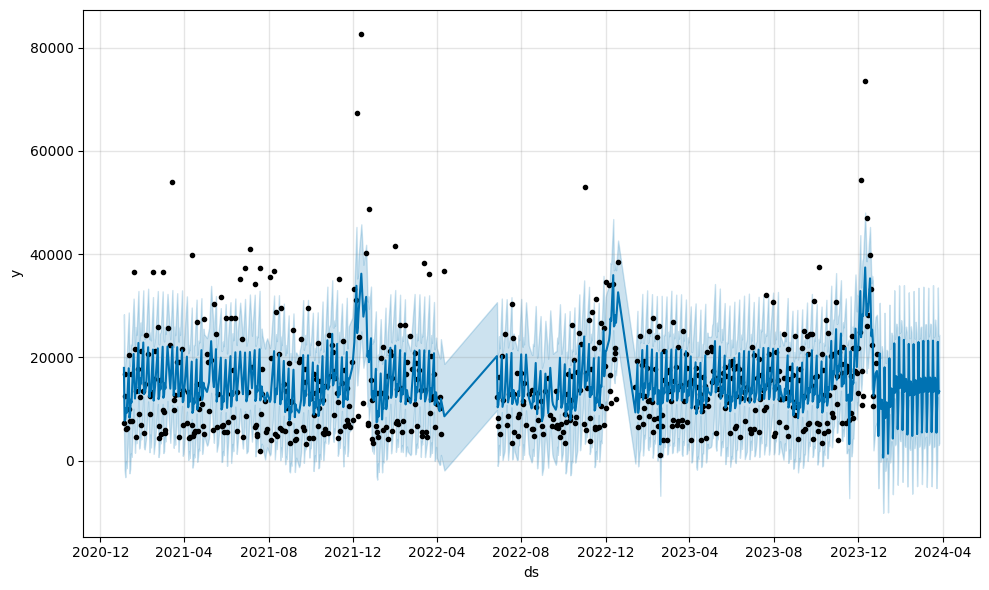

In [38]:
fig1 = m.plot(forecast)

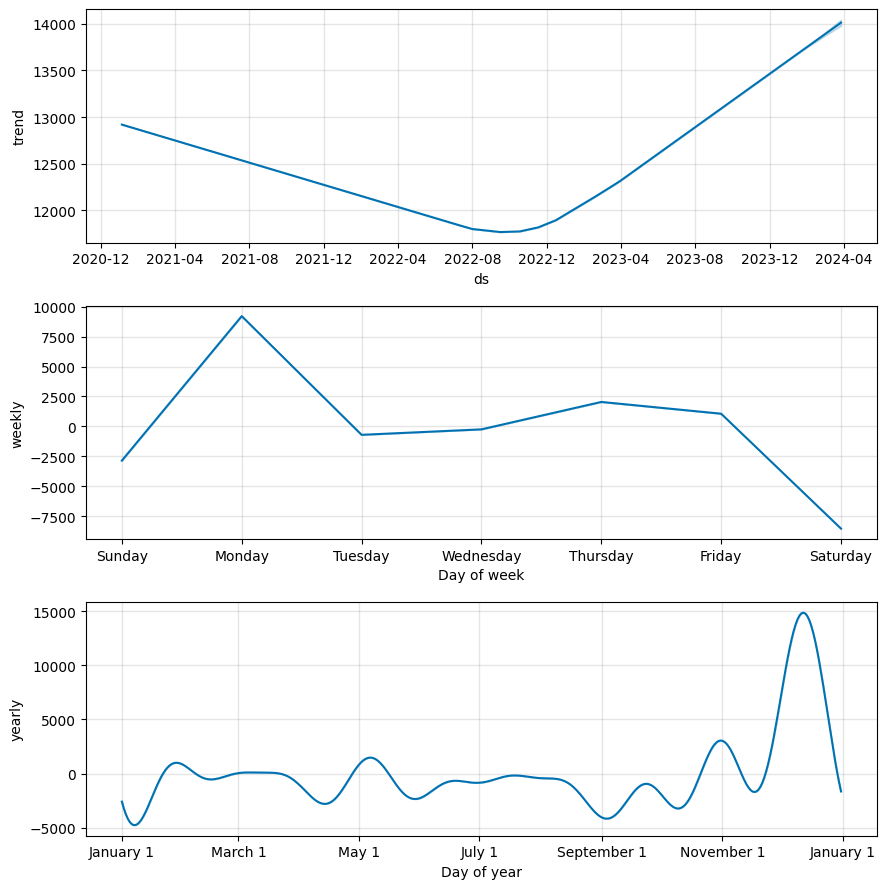

In [39]:
fig2 = m.plot_components(forecast)

In [40]:
from prophet.plot import plot_plotly, plot_components_plotly

plot_plotly(m, forecast)

In [41]:
plot_components_plotly(m, forecast)

/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.


/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.


/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.


/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_tra

In [42]:
# TRATANDO de probar el modelo
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import numpy as np

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df_prophet['ds'], df_prophet['y'], test_size=0.2, random_state=0)

# Train the Prophet model
m = Prophet()
m.fit(pd.DataFrame({'ds': X_train, 'y': y_train}))

# Generate predictions for the testing data
future = pd.DataFrame({'ds': X_test})
forecast = m.predict(future)

# Calculate evaluation metrics
mse = mean_squared_error(y_test, forecast['yhat'])
rmse = np.sqrt(mse)
mae = np.mean(np.abs(y_test - forecast['yhat']))

print("Root Mean Squared Error (RMSE):", rmse)
print("Mean Absolute Error (MAE):", mae)

15:23:36 - cmdstanpy - INFO - Chain [1] start processing
15:23:37 - cmdstanpy - INFO - Chain [1] done processing


Root Mean Squared Error (RMSE): 10316.148479455887
Mean Absolute Error (MAE): 8535.956197192043


# 4. Evaluación

# 5. Deployment